<a href="https://colab.research.google.com/github/NickKar30/GM-HSE-AI-masters-course/blob/main/homeworks/base/GenDL_HT4_Base.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Домашнее задание 4 (base): авторегрессионные модели и мультимодальность

В этом домашнем задании вам предлагается обучить авторегрессионную модель для генерации изображений (PixelCNN), а также сделать подход мультимодальным,  обусловив модель на CLIP-эмбеддинги.

In [ ]:
from datasets import load_dataset, Dataset
import torch
from diffusers import VQModel
from PIL import Image
from torchvision import transforms, models
from transformers import AutoTokenizer, CLIPTextModel
import torch.nn.functional as F
import torch.nn as nn
try:
    import pytorch_lightning as pl
except ModuleNotFoundError:
    !pip install --quiet pytorch-lightning>=1.4
    import pytorch_lightning as pl
import torch.optim as optim
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint
from torch.utils.data import DataLoader
import os
from tqdm.auto import tqdm
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import pandas as pd
from scipy.linalg import sqrtm

In [ ]:
import os
os.environ["TOKENIZERS_PARALLELISM"] = "false"

In [ ]:
CHECKPOINT_PATH = "/kaggle/working/saved_models/ar_models"
device = "cuda" if torch.cuda.is_available() else "cpu"

### Задание 1 (0 баллов)

Скачайте [датасет про птиц с HuggingFace](https://huggingface.co/datasets/weiywang/CUB_200_2011_CAP).

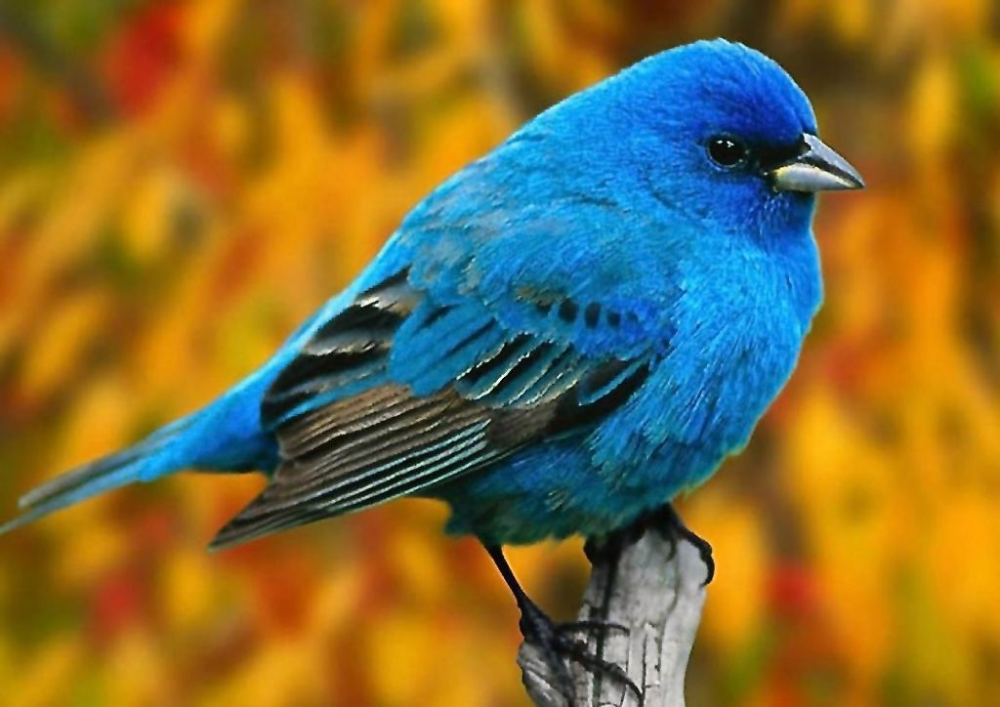

In [ ]:
ds = load_dataset("weiywang/CUB_200_2011_CAP")

README.md:   0%|          | 0.00/372 [00:00<?, ?B/s]

data/train-00000-of-00003.parquet:   0%|          | 0.00/385M [00:00<?, ?B/s]

data/train-00001-of-00003.parquet:   0%|          | 0.00/387M [00:00<?, ?B/s]

data/train-00002-of-00003.parquet:   0%|          | 0.00/376M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/11787 [00:00<?, ? examples/s]

### UPD: VQ-VAE

VQ-VAE - это автоэнкодер, который позволяет сжимать большие входные изображения в дискретное латентное пространство (последовательность кодов) и декодировать их обратно (см. рис).

<img src="https://substackcdn.com/image/fetch/$s_!dRiM!,f_auto,q_auto:good,fl_progressive:steep/https%3A%2F%2Fsubstack-post-media.s3.amazonaws.com%2Fpublic%2Fimages%2F81630fcc-b23e-4f06-831f-690aff70e03b_1215x476.png" width="800" height="400">

VQ-VAE состоит из трех частей. Энкодер кодирует входное изображение $x \in \mathbb{R}^{B \times C \times H \times W}$ в непрерывное латентное пространство $z_e \in \mathbb{R}^{B \times D \times H_{h} \times W_{h}}$. Quantizer смотрит на каждый вектор из $z_e$ ($H_{h} \times W_{h}$ штук длины $D$) и заменяет их на ближайший похожий вектор из словаря-векторов (codebook), который обучался вместе с моделью. Сам $z_e$после такой операции заменяется на $z_q$ (те же размеры, но каждый вектор заменен на ближайшего из кодбука). $z_q$ можно хранить либо как непрерывный тензор $\mathbb{R}^{B \times D \times H_{h} \times W_{h}}$, либо просто хранить $B \times  H_{h} \times W_{h}$ дискретных индексов из кодбука, где индексы соответствуют номеру вектора в кодбуке (для примера, если у нас 4096 векторов в кодбуке и мы $z_e$ заменили на вектора на местах $1, 2000, 2, 10$ из кодбука, то теперь $z_q$ в дискретном виде это просто массив $1, 200, 2, 10$). Декодер, последняя часть VQ-VAE, берет $z_q$ и переводит из кодов обратно в вектора из кодбука (если $z_q$ был в виде кодов, а не векторов) и прогоняет $z_q$ через набор слоев, чтобы получить изображение $\hat{x} \simeq x$.


$H_{h} \times W_{h}$ как правило сильно меньше оригинальных $H \times W$, поэтому многие генеративные модели используют VQ-VAE для генерации высококачественных изображений без значительного усложнения вычислительной сложности. Действительно, если вместо авторегрессионной генерации $С \times H \times W$, где $H, W \ge 128$ мы будем работать с дискретным тензором $H_{h} \times W_{h}$, где $H_h, W_h \le 32$, то мы сможем генерировать качественные изображения с той же вычислительной сложностью как если бы сделали resize изначальных картинок в $32\times32$, но при этом не теряем в качестве изображений (ведь финальное изображение получается прогоном кодов через декодер).

Давайте посмотрим как это работает:

In [ ]:
# Скачаем предобученную VQ-VAE
vqvae = VQModel.from_pretrained("microsoft/vq-diffusion-ithq", subfolder="vqvae")
vqvae.to(device)

config.json:   0%|          | 0.00/606 [00:00<?, ?B/s]

An error occurred while trying to fetch microsoft/vq-diffusion-ithq: microsoft/vq-diffusion-ithq does not appear to have a file named diffusion_pytorch_model.safetensors.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


vqvae/diffusion_pytorch_model.bin:   0%|          | 0.00/256M [00:00<?, ?B/s]

VQModel(
  (encoder): Encoder(
    (conv_in): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (down_blocks): ModuleList(
      (0): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0-1): 2 x ResnetBlock2D(
            (norm1): GroupNorm(32, 64, eps=1e-06, affine=True)
            (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (norm2): GroupNorm(32, 64, eps=1e-06, affine=True)
            (dropout): Dropout(p=0.0, inplace=False)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (nonlinearity): SiLU()
          )
        )
        (downsamplers): ModuleList(
          (0): Downsample2D(
            (conv): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2))
          )
        )
      )
      (1): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0): ResnetBlock2D(
            (norm1): GroupNorm(32, 64, eps=1e-06, affine=True)
            (conv1): Conv2d(64

Скачаем картинку для примера

In [ ]:
!wget "https://upload.wikimedia.org/wikipedia/commons/1/16/Myophonus_caeruleus_-_Ang_Khang_edit1.jpg" -O example.jpg

--2025-11-25 17:37:04--  https://upload.wikimedia.org/wikipedia/commons/1/16/Myophonus_caeruleus_-_Ang_Khang_edit1.jpg
Resolving upload.wikimedia.org (upload.wikimedia.org)... 185.15.59.240, 2a02:ec80:300:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|185.15.59.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1474949 (1.4M) [image/jpeg]
Saving to: ‘example.jpg’

example.jpg         100%[===================>]   1.41M  --.-KB/s    in 0.06s   

2025-11-25 17:37:05 (24.8 MB/s) - ‘example.jpg’ saved [1474949/1474949]



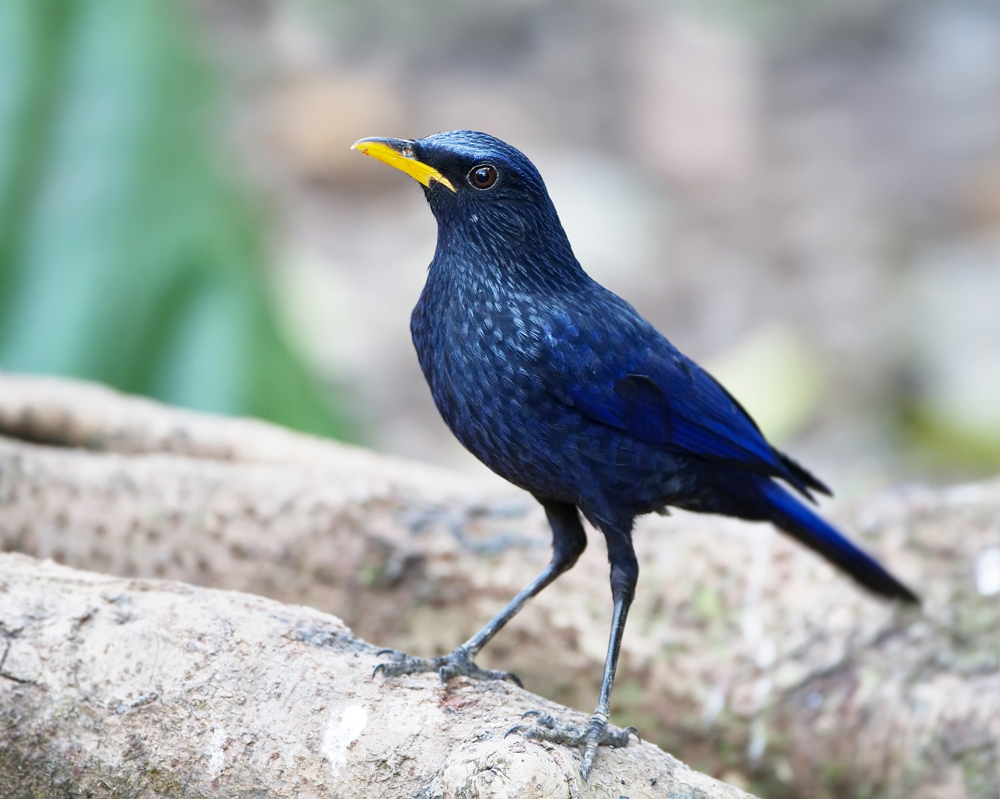

In [ ]:
img = Image.open("example.jpg")
img

VQ-VAE этот работает на изображениях $256\times 256$, поэтому ресайзим

In [ ]:
x = transforms.Resize((256, 256))(img)
x = transforms.ToTensor()(x)
x.shape

torch.Size([3, 256, 256])

Код для получения кодов и декодирования изображения:

In [ ]:
def img_to_codes(x, vqvae):
    if x.ndim != 4:
        x = x.unsqueeze(0)
    # для нормализации вход не [0, 1], а [-1, 1]
    x = x * 2 - 1
    # применяем энкодер
    latent = vqvae.encode(x).latents
    # получаем z_q и соответствующие коды
    quant, commit_loss, (_, _, indices) = vqvae.quantize(latent)
    # коды тут flatten, решейпим обратно
    B, _, Hc, Wc = latent.shape
    if indices.dim() == 1:
        codes = indices.view(B, Hc, Wc)
    else:
        codes = indices
    return codes

def codes_to_img(codes, vqvae):
    B, Hc, Wc = codes.shape
    codes = codes.view(-1)
    # получаем непрерывное z_q из соответствующих кодов,
    # смотря на вектора из кодбука по индексам
    quant = vqvae.quantize.get_codebook_entry(
        codes,
        shape=(B, Hc, Wc, vqvae.quantize.vq_embed_dim)  # (B, H, W, C)
    )
    # декодируем
    quant2 = vqvae.post_quant_conv(quant)
    dec = vqvae.decoder(quant2, quant if vqvae.config.norm_type == "spatial" else None)
    return (dec + 1) / 2

Применим:

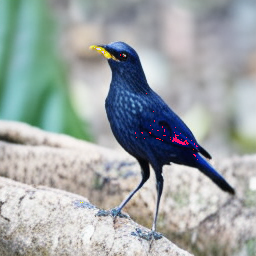

In [ ]:
codes = img_to_codes(x.to(device), vqvae)
hat_x = codes_to_img(codes, vqvae)
transforms.ToPILImage()(hat_x[0])

In [ ]:
codes

tensor([[[ 817, 2035, 1131,  ..., 2121, 3251,  308],
         [ 959, 3175, 3348,  ...,  798,  890,  626],
         [4008,  485, 1446,  ...,  300, 2945,  113],
         ...,
         [1287, 3999, 2154,  ..., 1070, 2207, 1166],
         [3132, 4010,  896,  ...,  729, 2359, 3617],
         [1282, 1434, 3435,  ...,  312,  109, 1547]]], device='cuda:0')

Видим, что у нас получилось довольно хорошо восстановить изображения из кодов. Но какие размеры у `codes`?

In [ ]:
codes.shape

torch.Size([1, 32, 32])

$B=1$, т.е. вместо $3\times 256\times 256$ (RGB) мы получаем всего лишь $32\times 32$.

Раньше, дискретных значений было в одном пикселе было $3 \cdot 256$ (цвета в RGB по каждому каналу). Теперь кол-во дискретных значения задается количеством кодов в кодбуке vqvae $N_q$

In [ ]:
vqvae.config.num_vq_embeddings

4096

Как и прежде, мы можем генерировать подобные дискретные тензоры авторегрессионно с помощью PixelCNN, но если раньше мы работали в пространстве изображений, то теперь будем работать в латентном. Как и раньше, мы будем считать, что $32\times32$ тензор это последовательность токенов со значениями из $[0, N_q-1]$, которую мы считываем построчно слево направо. Наш PixelCNN, как и раньше, будет смотреть только на предыдущие токены, чтобы генерировать новый. Модель каждый шаг будет предсказывать вероятностное распределение на словаре: $[0, N_q-1]$

То есть, все буквально, как и раньше, но вместо RGB изображений, мы будем генерировать `codes`. Чтобы получить RGB, мы просто прокинем codes через декодер VQ-VAE и получим RGB изображений в высоком разрешении.

P.S. Поскольку VQ-VAE сильно сжимает изображение, мы заодно избавляемся от высокочастотного шума, который присутствует в цветных натуральных изображениях и мешает авторегрессионным генераторам делать хорошую генерацию. В изначальной версии ДЗ PixelCNN могло получить хороший bpd, но генерировало RGB шум из-за слишком разнообразного фона на картинках птиц. VQ-VAE, засчет сжатия, делает каждый токен очень значимым (нет двух соседних токенов, которые по сути отвечают лишь за две соседние маленькие точки фона, мешая PixelCNN обучиться). Действительно, если изначально картинка была с стороной 256, а стала с 32 в  `codes`, то каждый токен отвечает за участок размера $8\times8$, что куда более значимо, чем один пиксель в исходном изображении. Можно было бы сказать, что такого же эффекта "значимости" можно было бы добиться просто resize в $32\times 32$ RGB картинки, но PixelCNN путался бы из-за цветов (3 канала в RGB, в `codes` нет каналов), а также сами пиксели имели бы лишь поверхностное значение. В VQ-VAE токены смоделированы специально для сжатия и восстановления обратно в $256\times 256$, поэтому каждый токен содержит в себе более глубокую и детальную информацию, чем просто resize-нутый пиксель.

### Задание 2 (1 балл).

Скачайте любую версию предобученного CLIP на ваш вкус, примените текстовый кодировщик к описаниям птиц из датасета (столбец "text") и сохраните получившиеся эмбеддинги.

Возьмите из датасета две картинки с визуально похожими птицами и посчитайте косинусную близость эмбеддингов подписей к этим фото, оцените корректность результата.

In [ ]:
model = CLIPTextModel.from_pretrained("openai/clip-vit-base-patch32").to(device)
tokenizer = AutoTokenizer.from_pretrained("openai/clip-vit-base-patch32")

config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

In [ ]:
texts = [item["text"] for item in ds["train"]]
all_embs = encode_texts(texts, tokenizer, model)
torch.save(all_embs, "all_embs.pt")

In [ ]:
def encode_texts(texts, tokenizer, model, batch_size=64):
    all_embs = []

    for i in range(0, len(texts), batch_size):
        batch = texts[i:i+batch_size]
        tokens = tokenizer(
            batch,
            padding=True,
            truncation=True,
            max_length=77,
            return_tensors="pt"
        ).to(device)

        with torch.no_grad():
            emb = model(**tokens).pooler_output

        all_embs.append(emb.cpu())
        torch.cuda.empty_cache()

    return torch.cat(all_embs, dim=0)


In [ ]:
similar_score = F.cosine_similarity(all_embs[4].unsqueeze(0), all_embs[5].unsqueeze(0))
print(similar_score)

tensor([0.8822])


### Задание 3 (0.5 балла).

Соберите картинки и получившиеся эмбеддинги в датасеты. Сохраните два датасета: один только с изображениями, другой - с изображениями и эмбеддингами подписей.

- Сконвертируйте картинки в соответствующие `codes` (используйте функции выше)

Hint: внимательно посмотрите на кол-во каналов в изображениях датасета и размеры картинок, предобработайте картинки перед подачей в VQ-VAE

Hint 2: сначала используется сабсет из вашего датасета для дебага, потому что датасет конвертируется долго, после дебага используйте весь

In [ ]:
from huggingface_hub import login
login()

In [ ]:
def convert_image(ds):
    for item in ds:
        img = item["image"]
        if img.mode != "RGB":
            img = img.convert("RGB")

        x = transforms.Resize((256, 256))(img)
        x = transforms.ToTensor()(x).to(device)

        yield {
            "image": x.cpu().numpy()
        }

In [ ]:
ds_images = Dataset.from_generator(
    lambda: convert_image(ds["train"]),
)

Generating train split: 0 examples [00:00, ? examples/s]

In [ ]:
ds_images.push_to_hub("Zharova/ds_images")

Uploading the dataset shards:   0%|          | 0/19 [00:00<?, ? shards/s]

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  31%|###       | 33.6MB /  110MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  46%|####6     | 50.3MB /  109MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##2       | 25.0MB /  111MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  37%|###7      | 41.9MB /  112MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  31%|###       | 33.5MB /  109MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##3       | 25.1MB /  108MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##3       | 25.1MB /  108MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##2       | 25.1MB /  110MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  15%|#5        | 16.7MB /  111MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##2       | 25.2MB /  110MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##2       | 25.1MB /  110MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##2       | 25.1MB /  110MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  15%|#5        | 16.8MB /  111MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##2       | 25.1MB /  110MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  46%|####6     | 50.3MB /  109MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  23%|##3       | 25.2MB /  108MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  54%|#####4    | 58.6MB /  108MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  39%|###8      | 41.9MB /  108MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  22%|##2       | 25.1MB /  112MB            

README.md:   0%|          | 0.00/372 [00:00<?, ?B/s]

CommitInfo(commit_url='https://huggingface.co/datasets/Zharova/ds_images/commit/47fd928499d28b19594e11eb47d32c67d5feb9a2', commit_message='Upload dataset', commit_description='', oid='47fd928499d28b19594e11eb47d32c67d5feb9a2', pr_url=None, repo_url=RepoUrl('https://huggingface.co/datasets/Zharova/ds_images', endpoint='https://huggingface.co', repo_type='dataset', repo_id='Zharova/ds_images'), pr_revision=None, pr_num=None)

In [ ]:
def convert_full_dataset(ds, embed):
    for i, item in enumerate(ds):
        img = item["image"]
        if img.mode != "RGB":
            img = img.convert("RGB")

        x = transforms.Resize((256, 256))(img)
        x = transforms.ToTensor()(x).to(device)

        with torch.no_grad():
            codes = img_to_codes(x, vqvae)

        yield {
            "image": x.cpu().numpy(),
            "codes": codes.cpu().numpy(),
            "text_emb": embed[i].numpy()
        }

In [ ]:
all_embs = torch.load("all_embs.pt")

ds_full = Dataset.from_generator(
    lambda: convert_full_dataset(ds["train"], all_embs)
)

Generating train split: 0 examples [00:00, ? examples/s]

In [ ]:
ds_full.push_to_hub("Zharova/ds_full")

Uploading the dataset shards:   0%|          | 0/19 [00:00<?, ? shards/s]

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|##9       | 33.6MB /  112MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|##9       | 33.4MB /  112MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|##9       | 33.5MB /  114MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  36%|###6      | 41.9MB /  115MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  22%|##2       | 25.1MB /  112MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  38%|###7      | 41.9MB /  110MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  38%|###7      | 41.9MB /  111MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|##9       | 33.5MB /  113MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  37%|###6      | 41.9MB /  114MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  22%|##2       | 25.2MB /  113MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  37%|###7      | 41.8MB /  113MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  37%|###6      | 41.9MB /  113MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  37%|###6      | 41.9MB /  114MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|##9       | 33.5MB /  113MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|###       | 33.5MB /  112MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|###       | 33.5MB /  111MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|###       | 33.5MB /  111MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  30%|###       | 33.4MB /  111MB            

Creating parquet from Arrow format:   0%|          | 0/1 [00:00<?, ?ba/s]

Processing Files (0 / 0)      : |          |  0.00B /  0.00B            

New Data Upload               : |          |  0.00B /  0.00B            

                              :  36%|###6      | 41.9MB /  115MB            

No files have been modified since last commit. Skipping to prevent empty commit.


CommitInfo(commit_url='https://huggingface.co/datasets/Zharova/ds_full/commit/443167ac32bfc90e022fad17d18f39eb7891dce2', commit_message='Upload dataset', commit_description='', oid='443167ac32bfc90e022fad17d18f39eb7891dce2', pr_url=None, repo_url=RepoUrl('https://huggingface.co/datasets/Zharova/ds_full', endpoint='https://huggingface.co', repo_type='dataset', repo_id='Zharova/ds_full'), pr_revision=None, pr_num=None)

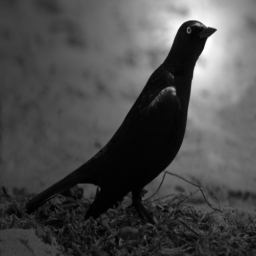

In [ ]:
transforms.ToPILImage()(torch.tensor(ds_full[1778]["image"])) #взяла эту картинку, так как здесь был перевод в RGB

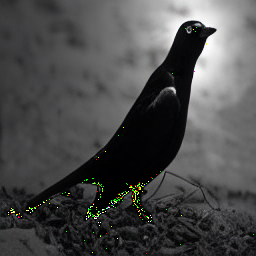

In [ ]:
codes = torch.tensor(ds_full[1778]["codes"]).to(device)
hat_x = codes_to_img(codes, vqvae)
transforms.ToPILImage()(hat_x[0])

### Задание 4 (2 балла).

- Обучите [модель из семинара (PixelCNN)](https://colab.research.google.com/drive/1EIsBxlTcz3ZB0j-ZxN1gWD2dSQq6krPj?usp=sharing) только на `codes` птиц. Модифицируйте размерности тензоров в модели, где это необходимо - чтобы она корректно работала с данными изображениями (обратите внимание на то, какие дискретные числа должны предсказывать ваша модель)

- Сделайте обучаемый `nn.Embedding` для `codes` перед подачей в слои свертки

- Вы можете менять гиперпараметры для улучшения качества генерации

- Выведите на экран 10 сгенерированных картинок, оцените результат, напишите выводы

Hint: добавьте конвертацию кодов в изображения в функцию отрисовки картинок, а не в `sample`.

In [ ]:
# ds_images = load_dataset("Zharova/ds_images").with_format("torch")
ds_full = load_dataset("Zharova/ds_full").with_format("torch")
codes_data = [item['codes'] for item in tqdm(ds_full["train"])]

README.md:   0%|          | 0.00/406 [00:00<?, ?B/s]

Resolving data files:   0%|          | 0/19 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/19 [00:00<?, ?it/s]

data/train-00000-of-00019.parquet:   0%|          | 0.00/112M [00:00<?, ?B/s]

data/train-00001-of-00019.parquet:   0%|          | 0.00/112M [00:00<?, ?B/s]

data/train-00002-of-00019.parquet:   0%|          | 0.00/114M [00:00<?, ?B/s]

data/train-00003-of-00019.parquet:   0%|          | 0.00/115M [00:00<?, ?B/s]

data/train-00004-of-00019.parquet:   0%|          | 0.00/112M [00:00<?, ?B/s]

data/train-00005-of-00019.parquet:   0%|          | 0.00/110M [00:00<?, ?B/s]

data/train-00006-of-00019.parquet:   0%|          | 0.00/111M [00:00<?, ?B/s]

data/train-00007-of-00019.parquet:   0%|          | 0.00/113M [00:00<?, ?B/s]

data/train-00008-of-00019.parquet:   0%|          | 0.00/114M [00:00<?, ?B/s]

data/train-00009-of-00019.parquet:   0%|          | 0.00/113M [00:00<?, ?B/s]

data/train-00010-of-00019.parquet:   0%|          | 0.00/113M [00:00<?, ?B/s]

data/train-00011-of-00019.parquet:   0%|          | 0.00/113M [00:00<?, ?B/s]

data/train-00012-of-00019.parquet:   0%|          | 0.00/114M [00:00<?, ?B/s]

data/train-00013-of-00019.parquet:   0%|          | 0.00/113M [00:00<?, ?B/s]

data/train-00014-of-00019.parquet:   0%|          | 0.00/112M [00:00<?, ?B/s]

data/train-00015-of-00019.parquet:   0%|          | 0.00/111M [00:00<?, ?B/s]

data/train-00016-of-00019.parquet:   0%|          | 0.00/111M [00:00<?, ?B/s]

data/train-00017-of-00019.parquet:   0%|          | 0.00/111M [00:00<?, ?B/s]

data/train-00018-of-00019.parquet:   0%|          | 0.00/115M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/11787 [00:00<?, ? examples/s]

Loading dataset shards:   0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/11787 [00:00<?, ?it/s]

In [ ]:
train_dataset, val_dataset_full = train_test_split(codes_data, test_size=0.3, random_state=42)
val_dataset, test_dataset = train_test_split(val_dataset_full, test_size=0.3, random_state=42)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=3)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False, num_workers=3)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False, num_workers=3)

all_codes = torch.stack([item for item in codes_data]).squeeze(1)
num_embeddings = int(all_codes.max().item()) + 2

print(f"Train samples: {len(train_dataset)}, Val samples: {len(val_dataset)}, Test samples: {len(test_dataset)}")

Train samples: 8250, Val samples: 2475, Test samples: 1062


In [ ]:
class MaskedConvolution(nn.Module):
    def __init__(self, c_in, c_out, mask, **kwargs):
        super().__init__()
        kernel_size = (mask.shape[0], mask.shape[1])
        dilation = kwargs.pop("dilation", 1)
        padding = tuple([dilation*(kernel_size[i]-1)//2 for i in range(2)])
        self.conv = nn.Conv2d(c_in, c_out, kernel_size, padding=padding, dilation=dilation, **kwargs)
        self.register_buffer('mask', mask[None,None])

    def forward(self, x):
        self.conv.weight.data *= self.mask
        return self.conv(x)

In [ ]:
class VerticalStackConvolution(MaskedConvolution):
    def __init__(self, c_in, c_out, kernel_size=3, mask_center=False, **kwargs):
        mask = torch.ones(kernel_size, kernel_size)
        mask[kernel_size//2+1:,:] = 0
        if mask_center:
            mask[kernel_size//2,:] = 0
        super().__init__(c_in, c_out, mask, **kwargs)

class HorizontalStackConvolution(MaskedConvolution):
    def __init__(self, c_in, c_out, kernel_size=3, mask_center=False, **kwargs):
        mask = torch.ones(1,kernel_size)
        mask[0,kernel_size//2+1:] = 0
        if mask_center:
            mask[0,kernel_size//2] = 0
        super().__init__(c_in, c_out, mask, **kwargs)

In [ ]:
class GatedMaskedConv(nn.Module):
    def __init__(self, c_in, dilation=1):
        super().__init__()
        self.conv_vert = VerticalStackConvolution(c_in, 2*c_in, kernel_size=3, dilation=dilation)
        self.conv_horiz = HorizontalStackConvolution(c_in, 2*c_in, kernel_size=3, dilation=dilation)
        self.conv_vert_to_horiz = nn.Conv2d(2*c_in, 2*c_in, kernel_size=1)
        self.conv_horiz_1x1 = nn.Conv2d(c_in, c_in, kernel_size=1)

    def forward(self, v_stack, h_stack):
        v_stack_feat = self.conv_vert(v_stack)
        v_val, v_gate = v_stack_feat.chunk(2, dim=1)
        v_stack_out = torch.tanh(v_val) * torch.sigmoid(v_gate)

        h_stack_feat = self.conv_horiz(h_stack)
        h_stack_feat = h_stack_feat + self.conv_vert_to_horiz(v_stack_feat)
        h_val, h_gate = h_stack_feat.chunk(2, dim=1)
        h_stack_feat = torch.tanh(h_val) * torch.sigmoid(h_gate)
        h_stack_out = self.conv_horiz_1x1(h_stack_feat)
        h_stack_out = h_stack_out + h_stack

        return v_stack_out, h_stack_out

In [ ]:
class PixelCNN(pl.LightningModule):
    def __init__(self, num_embeddings=4096, c_hidden=64, emb_dim=64):
        super().__init__()
        self.save_hyperparameters()

        self.embedding = nn.Embedding(num_embeddings, emb_dim)

        self.conv_vstack = VerticalStackConvolution(emb_dim, c_hidden, mask_center=True)
        self.conv_hstack = HorizontalStackConvolution(emb_dim, c_hidden, mask_center=True)

        self.conv_layers = nn.ModuleList([
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=2),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=4),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=2),
            GatedMaskedConv(c_hidden)
        ])

        self.conv_out = nn.Conv2d(c_hidden, num_embeddings, kernel_size=1, padding=0)

    def forward(self, x):
        x_emb = self.embedding(x)
        x_emb = x_emb.permute(0, 3, 1, 2)

        v_stack = self.conv_vstack(x_emb)
        h_stack = self.conv_hstack(x_emb)

        for layer in self.conv_layers:
            v_stack, h_stack = layer(v_stack, h_stack)

        out = self.conv_out(F.elu(h_stack))

        return out

    def calc_likelihood(self, x):
        pred = self.forward(x)
        nll = F.cross_entropy(pred, x, reduction='none')
        bpd = nll.mean(dim=[1,2]) * np.log2(np.exp(1))
        return bpd.mean()

    @torch.no_grad()
    def sample(self, img_shape, img=None, temperature=1.0):
        device = self.embedding.weight.device
        if img is None:
            img = torch.full(img_shape, -1, dtype=torch.long, device=device)
        else:
            img = img.to(device)
        for h in tqdm(range(img_shape[1]), leave=False):
            for w in range(img_shape[2]):
                if (img[:,h,w] != -1).all().item():
                    continue
                x = img[:, :h+1, :].clone()
                x = torch.clamp(x, min=0).to(device)
                pred = self.forward(x)
                pred = pred[:,:,h,w] / temperature
                probs = F.softmax(pred, dim=-1)
                img[:,h,w] = torch.multinomial(probs, 1).squeeze(-1)
        return img.cpu()

    def configure_optimizers(self):
        optimizer = optim.Adam(self.parameters(), lr=2e-4)
        scheduler = optim.lr_scheduler.StepLR(optimizer, 10, gamma=0.97)
        return [optimizer], [scheduler]

    def training_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch[0])
        self.log('train_bpd', loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch[0])
        self.log('val_bpd', loss, prog_bar=True)

    def test_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch[0])
        self.log('test_bpd', loss)

In [ ]:
def train_model(**kwargs):
    trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, "PixelCNN"),
                         accelerator="gpu" if str(device).startswith("cuda") else "cpu",
                         devices=1,
                         max_epochs=max_epochs,
                         callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_bpd"),
                                    LearningRateMonitor("epoch")])
    result = None
    pretrained_filename = os.path.join(CHECKPOINT_PATH, "PixelCNN.ckpt")
    if os.path.isfile(pretrained_filename):
        print("Found pretrained model, loading...")
        model = PixelCNN.load_from_checkpoint(pretrained_filename)
        ckpt = torch.load(pretrained_filename, map_location=device)
        result = ckpt.get("result", None)
    else:
        model = PixelCNN(**kwargs)
        trainer.fit(model, train_loader, val_loader)
    model = model.to(device)

    if result is None:
        val_result = trainer.test(model, val_loader, verbose=False)
        test_result = trainer.test(model, test_loader, verbose=False)
        result = {"test": test_result, "val": val_result}
    return model, result

In [ ]:
max_epochs = 300
model, result = train_model(num_embeddings=4096, c_hidden=128, emb_dim=64)
test_res = result["test"][0]
print("Test bits per dimension: %4.3fbpd" % (test_res["test_loss"] if "test_loss" in test_res else test_res["test_bpd"]))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name        | Type                       | Params | Mode 
-------------------------------------------------------------------
0 | embedding   | Embedding                  | 262 K  | train
1 | conv_vstack | VerticalStackConvolution   | 73.9 K | train
2 | conv_hstack | HorizontalStackConvolution | 24.7 K | train
3 | conv_layers | ModuleList                 | 3.3 M  | train
4 | conv_out    | Conv2d                     | 528 K  | train
-------------------------------------------------------------------
4.2 M     Trainable params
0         Non-trainable params
4.2 M     Total params
16.885    Total estimated model par

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=300` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

Test bits per dimension: 10.533bpd


In [ ]:
def plot_generated_samples(model, vqvae, num_samples=10, temperature=0.3):
    model.eval()
    with torch.no_grad():
        codes_shape = (num_samples, 32, 32)
        generated_codes = model.sample(codes_shape, temperature=temperature)
        generated_images = []
        for i in range(num_samples):
            codes_i = generated_codes[i:i+1].to(device)
            img_tensor = codes_to_img(codes_i.to("cpu"), vqvae.to("cpu"))
            img = transforms.ToPILImage()(img_tensor[0].cpu())
            generated_images.append(img)

        # Рисуем
        fig, axes = plt.subplots(2, 5, figsize=(15, 6))
        axes = axes.flatten()

        for i, img in enumerate(generated_images):
            if i < len(axes):
                axes[i].imshow(img)
                axes[i].axis('off')

        plt.tight_layout()
        plt.show()

    return generated_images

  0%|          | 0/32 [00:00<?, ?it/s]

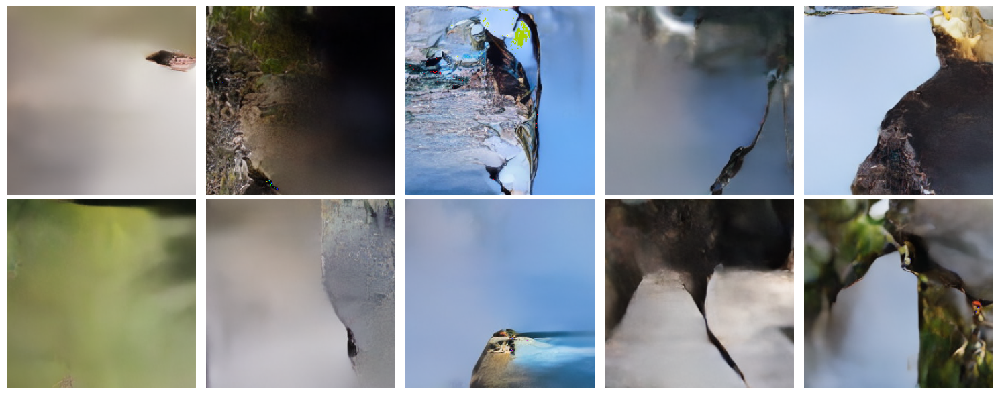

In [ ]:
generated_imgs = plot_generated_samples(model, vqvae, num_samples=10, temperature=0.9)

### Задание 5 (3.5 балла).

- Добавьте сохраненные эмбеддинги подписей к архитектуре PixelCNN (это можно сделать любым способом - прибавить эмбеддинги, сконкатенировать их, использовать cross-attention или любой другой подход).

- Обучите такую conditional-модель на птицах и эмбеддингах текстов, выведите на экран по 10 промптам, похожим по формату на промпты из трейна, сгенерированные картинки. Оцените результат, напишите выводы (здесь вы тоже можете менять гиперпараметры модели)

**Hint:** для улучшения качества в последующих заданиях можете прочитать сначала условие задания 6

In [ ]:
embed_data = [item['text_emb'] for item in tqdm(ds_full["train"])]

  0%|          | 0/11787 [00:00<?, ?it/s]

In [ ]:
class ConDataset(Dataset):
    def __init__(self, codes, embeds):
        codes_t = []
        for c in codes:
            t = torch.as_tensor(c).squeeze()
            t = t.long()
            codes_t.append(t)
        self.codes = torch.stack(codes_t)  # [B, Hc, Wc]

        emb_t = [torch.as_tensor(e).float() for e in embeds]
        self.embeds = torch.stack(emb_t)   # [B, D]

    def __len__(self):
        return self.codes.shape[0]

    def __getitem__(self, idx):
        return {
            "codes": self.codes[idx],
            "embed": self.embeds[idx]
        }

In [ ]:
# Разделение данных
train_codes, val_codes_full, train_embeds, val_embeds_full = train_test_split(
    codes_data, embed_data, test_size=0.3, random_state=42
)
val_codes, test_codes, val_embeds, test_embeds = train_test_split(
    val_codes_full, val_embeds_full, test_size=0.3, random_state=42
)

train_dataset = ConDataset(train_codes, train_embeds)
val_dataset = ConDataset(val_codes, val_embeds)
test_dataset = ConDataset(test_codes, test_embeds)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=3, pin_memory=True)
val_loader   = DataLoader(val_dataset, batch_size=64, shuffle=False, num_workers=3, pin_memory=True)
test_loader  = DataLoader(test_dataset, batch_size=64, shuffle=False, num_workers=3, pin_memory=True)

print(f"Train samples: {len(train_dataset)}, Val samples: {len(val_dataset)}, Test samples: {len(test_dataset)}")

Train samples: 8250, Val samples: 2475, Test samples: 1062


In [ ]:
class ConditionalPixelCNN(pl.LightningModule):
    def __init__(self, num_embeddings, c_hidden, emb_dim, cond_dim):
        super().__init__()
        self.save_hyperparameters()

        self.embedding = nn.Embedding(num_embeddings, emb_dim)
        self.cond_proj = nn.Linear(cond_dim, emb_dim * 32 * 32)
        self.conv_vstack = VerticalStackConvolution(emb_dim, c_hidden, mask_center=True)
        self.conv_hstack = HorizontalStackConvolution(emb_dim, c_hidden, mask_center=True)

        self.conv_layers = nn.ModuleList([
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=2),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=4),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=2),
            GatedMaskedConv(c_hidden)
        ])

        self.conv_out = nn.Conv2d(c_hidden, num_embeddings, kernel_size=1)

    def forward(self, x, cond):
        B, H, W = x.shape
        x_emb = self.embedding(x).permute(0, 3, 1, 2)
        cond_proj = self.cond_proj(cond).view(B, -1, H, W)
        x_emb = x_emb + cond_proj

        v_stack = self.conv_vstack(x_emb)
        h_stack = self.conv_hstack(x_emb)

        for layer in self.conv_layers:
            v_stack, h_stack = layer(v_stack, h_stack)

        return self.conv_out(F.elu(h_stack))

    def calc_likelihood(self, x, cond):
        pred = self.forward(x, cond)
        nll = F.cross_entropy(pred, x, reduction="none")
        bpd = nll.mean(dim=[1,2]) * np.log2(np.exp(1))
        return bpd.mean()

    @torch.no_grad()
    def sample(self, cond_embed, img_shape, img=None, temperature=1.0):
        B, H, W = img_shape
        img = torch.full((B, H, W), -1, dtype=torch.long, device=cond_embed.device)

        for h in tqdm(range(H), leave=False):
            for w in range(W):
                x = torch.clamp(img.clone(), min=0)
                pred = self.forward(x, cond_embed)
                logits = pred[:, :, h, w] / temperature
                probs = F.softmax(logits, dim=-1)
                img[:, h, w] = torch.multinomial(probs, 1).squeeze(1)

        return img.cpu()

    def training_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch["codes"], batch["embed"])
        self.log("train_bpd", loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch["codes"], batch["embed"])
        self.log("val_bpd", loss, prog_bar=True)

    def test_step(self, batch, batch_idx):
        loss = self.calc_likelihood(batch["codes"], batch["embed"])
        self.log("test_bpd", loss)

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=2e-4)
        scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.97)
        return {"optimizer": optimizer, "lr_scheduler": scheduler}


In [ ]:
def train_con_model(**kwargs):
    trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, "ConditionalPixelCNN"),
                         accelerator="gpu" if str(device).startswith("cuda") else "cpu",
                         devices=1,
                         max_epochs=max_epochs,
                         callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_bpd"),
                                    LearningRateMonitor("epoch")])
    result = None
    pretrained_filename = os.path.join(CHECKPOINT_PATH, "ConditionalPixelCNN.ckpt")
    if os.path.isfile(pretrained_filename):
        print("Found pretrained model, loading...")
        model = ConditionalPixelCNN.load_from_checkpoint(pretrained_filename)
        ckpt = torch.load(pretrained_filename, map_location=device)
        result = ckpt.get("result", None)
    else:
        model = ConditionalPixelCNN(**kwargs)
        trainer.fit(model, train_loader, val_loader)
    model = model.to(device)

    if result is None:
        val_result = trainer.test(model, val_loader, verbose=False)
        test_result = trainer.test(model, test_loader, verbose=False)
        result = {"test": test_result, "val": val_result}
    return model, result

In [ ]:
max_epochs = 40
conModel, conResult = train_con_model(num_embeddings=4096, c_hidden=128, emb_dim=64, cond_dim=512)
conTest_res = conResult["test"][0]
print("Test bits per dimension: %4.3fbpd" % (conTest_res["test_loss"] if "test_loss" in conTest_res else conTest_res["test_bpd"]))
torch.save(conModel, "conditional_pixelcnn.pth")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name        | Type                       | Params | Mode 
-------------------------------------------------------------------
0 | embedding   | Embedding                  | 262 K  | train
1 | cond_proj   | Linear                     | 33.6 M | train
2 | conv_vstack | VerticalStackConvolution   | 73.9 K | train
3 | conv_hstack | HorizontalStackConvolution | 24.7 K | train
4 | conv_layers | ModuleList                 | 3.3 M  | train
5 | conv_out    | Conv2d                     | 528 K  | train
-------------------------------------------------------------------
37.8 M    Trainable params
0         Non-trainable par

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=40` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

Test bits per dimension: 10.595bpd


In [ ]:
prompts = ["a small yellow bird sitting on a branch", "a red bird with black head on a tree", "a brown bird standing in the grass",
          "a white bird flying in the blue sky", "a black bird perched on a rock", "a colorful bird with blue and yellow feathers",
          "a bird with a long beak standing in water", "a small bird sitting on a fence", "a bird with striped wings on a branch",
          "a bird with a red chest sitting in a bush"]
model = CLIPTextModel.from_pretrained("openai/clip-vit-base-patch32").to(device)
tokenizer = AutoTokenizer.from_pretrained("openai/clip-vit-base-patch32")
prompts_embs = encode_texts(prompts, tokenizer, model).to("cpu")

config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

In [ ]:
def plot_generated_samples_with_prompts(model, vqvae, prompts, prompts_embs, num_samples=10, temperature=0.3):
    model.eval()
    with torch.no_grad():
        generated_codes = model.sample(prompts_embs, (10, 32, 32), temperature=temperature)
        generated_images = []
        for i in range(num_samples):
            codes_i = generated_codes[i:i+1].to(device)
            img_tensor = codes_to_img(codes_i.to("cpu"), vqvae.to("cpu"))
            img = transforms.ToPILImage()(img_tensor[0].cpu())
            generated_images.append(img)

        # Рисуем
        fig, axes = plt.subplots(2, 5, figsize=(15, 6))
        axes = axes.flatten()

        for i, img in enumerate(generated_images):
            if i < len(axes):
                axes[i].imshow(img)
                axes[i].set_title(prompts[i], fontsize=8)
                axes[i].axis('off')

        plt.tight_layout()
        plt.show()

    return generated_images

  0%|          | 0/32 [00:00<?, ?it/s]

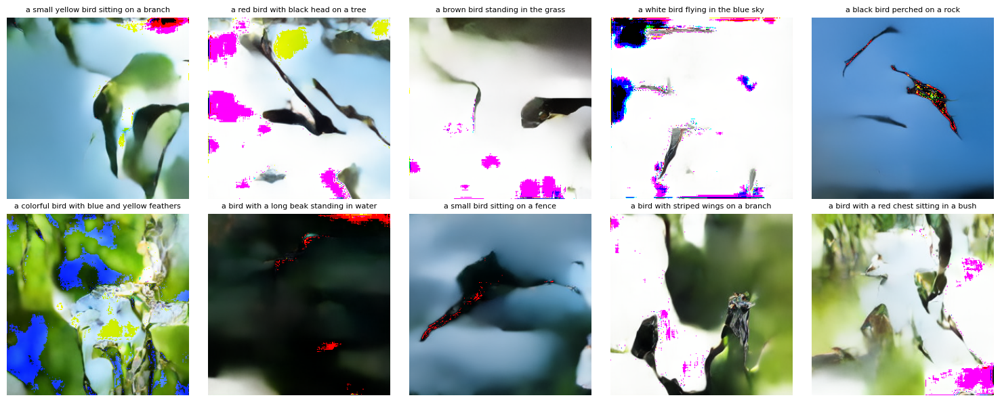

In [ ]:
generated_imgs = plot_generated_samples_with_prompts(conModel, vqvae, prompts, prompts_embs, num_samples=10, temperature=0.8)

  0%|          | 0/32 [00:00<?, ?it/s]

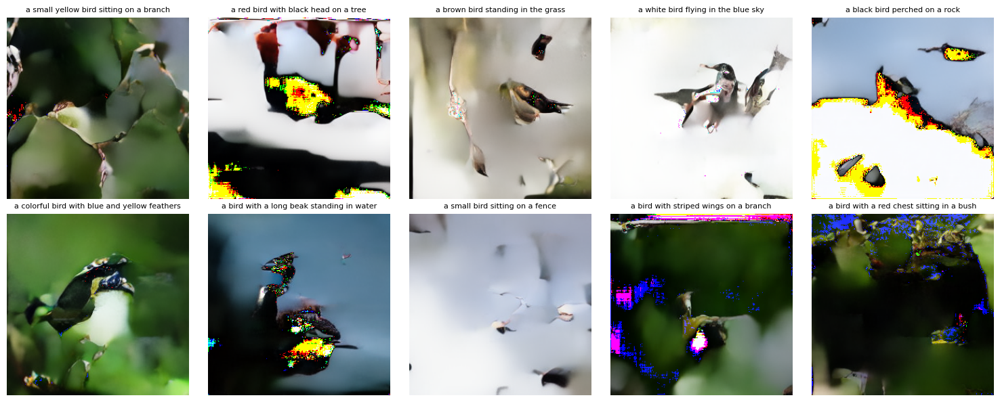

In [ ]:
generated_imgs = plot_generated_samples_with_prompts(conModel, vqvae, prompts, prompts_embs, num_samples=10, temperature=0.9)

### Задание 6 (0.5 балла).

Добавьте [classifier-free guidance](https://colab.research.google.com/drive/1EIsBxlTcz3ZB0j-ZxN1gWD2dSQq6krPj?usp=sharing) на этапе инференса для увеличения разнообразия генерации. Проведите несколько экспериментов.

Для улучшения качества и разнообразия генерации (опционально) можно добавить [classifier-free guidance и на этапе обучения](https://education.yandex.ru/handbook/ml/article/diffuzionnye-modeli):
- для этого во время обучения эмбеддинг промпта заменяется с какой-то фиксированной вероятностью (например, 10%) на эмбеддинг пустого промпта



In [ ]:
class ConditionalPixelCNNWithCFG(ConditionalPixelCNN):
    def __init__(self, num_embeddings, c_hidden, emb_dim, cond_dim, cfg_dropout_rate=0.1):
        super().__init__(num_embeddings, c_hidden, emb_dim, cond_dim)
        self.cfg_dropout_rate = cfg_dropout_rate

        self.null_embed = nn.Parameter(torch.zeros(1, cond_dim))
        nn.init.normal_(self.null_embed, mean=0.0, std=0.02)

    def forward(self, x, cond, use_cfg=False, cfg_scale=1.5):
        if use_cfg and self.training:
            batch_size = cond.shape[0]
            mask = torch.rand(batch_size, 1, device=cond.device) < self.cfg_dropout_rate
            cond = torch.where(mask, self.null_embed.expand_as(cond), cond)

        B, H, W = x.shape
        x_emb = self.embedding(x).permute(0, 3, 1, 2)
        cond_proj = self.cond_proj(cond).view(B, -1, H, W)
        x_emb = x_emb + cond_proj

        v_stack = self.conv_vstack(x_emb)
        h_stack = self.conv_hstack(x_emb)

        for layer in self.conv_layers:
            v_stack, h_stack = layer(v_stack, h_stack)

        return self.conv_out(F.elu(h_stack))

    def forward_with_cfg(self, x, cond, cfg_scale=1.5):
        null_cond = self.null_embed.expand(cond.shape[0], -1)

        logits_cond = self.forward(x, cond)
        logits_uncond = self.forward(x, null_cond)

        logits = logits_uncond + cfg_scale * (logits_cond - logits_uncond)

        return logits

    @torch.no_grad()
    def sample_with_cfg(self, cond_embed, img_shape, cfg_scale, temperature=1.0):
        B, H, W = img_shape
        img = torch.full((B, H, W), -1, dtype=torch.long, device=cond_embed.device)

        for h in tqdm(range(H), leave=False):
            for w in range(W):
                x = torch.clamp(img.clone(), min=0)

                pred = self.forward_with_cfg(x, cond_embed, cfg_scale=cfg_scale)

                logits = pred[:, :, h, w] / temperature
                probs = F.softmax(logits, dim=-1)
                img[:, h, w] = torch.multinomial(probs, 1).squeeze(1)

        return img.cpu()

    def training_step(self, batch, batch_idx):
        loss = self.calc_likelihood_with_cfg(batch["codes"], batch["embed"])
        self.log("train_bpd", loss, prog_bar=True)
        return loss

    def calc_likelihood_with_cfg(self, x, cond):
        batch_size = cond.shape[0]
        mask = torch.rand(batch_size, 1, device=cond.device) < self.cfg_dropout_rate
        cond_cfg = torch.where(mask, self.null_embed.expand_as(cond), cond)

        pred = self.forward(x, cond_cfg)
        nll = F.cross_entropy(pred, x, reduction="none")
        bpd = nll.mean(dim=[1,2]) * np.log2(np.exp(1))
        return bpd.mean()

In [ ]:
def train_cfg_model(**kwargs):
    trainer = pl.Trainer(
        default_root_dir=os.path.join(CHECKPOINT_PATH, "ConditionalPixelCNN_CFG"),
        accelerator="gpu" if str(device).startswith("cuda") else "cpu",
        devices=1,
        max_epochs=max_epochs,
        callbacks=[
            ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_bpd"),
            LearningRateMonitor("epoch")
        ]
    )

    result = None
    pretrained_filename = os.path.join(CHECKPOINT_PATH, "ConditionalPixelCNN_CFG.ckpt")

    if os.path.isfile(pretrained_filename):
        print("Found pretrained CFG model, loading...")
        model = ConditionalPixelCNNWithCFG.load_from_checkpoint(pretrained_filename)
        ckpt = torch.load(pretrained_filename, map_location=device)
        result = ckpt.get("result", None)
    else:
        print("Training new CFG model...")
        model = ConditionalPixelCNNWithCFG(**kwargs)
        trainer.fit(model, train_loader, val_loader)

    model = model.to(device)

    if result is None:
        val_result = trainer.test(model, val_loader, verbose=False)
        test_result = trainer.test(model, test_loader, verbose=False)
        result = {"test": test_result, "val": val_result}

    return model, result

In [ ]:
max_epochs = 50
cfgModel, cfgResult = train_cfg_model(num_embeddings=4096, c_hidden=128, emb_dim=64, cond_dim=512, cfg_dropout_rate=0.1)
cfgTest_res = cfgResult["test"][0]
print("Test bits per dimension: %4.3fbpd" % (cfgTest_res["test_loss"] if "test_loss" in cfgTest_res else cfgTest_res["test_bpd"]))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


Training new CFG model...


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type                       | Params | Mode 
--------------------------------------------------------------------
0 | embedding    | Embedding                  | 262 K  | train
1 | cond_proj    | Linear                     | 33.6 M | train
2 | conv_vstack  | VerticalStackConvolution   | 73.9 K | train
3 | conv_hstack  | HorizontalStackConvolution | 24.7 K | train
4 | conv_layers  | ModuleList                 | 3.3 M  | train
5 | conv_out     | Conv2d                     | 528 K  | train
  | other params | n/a                        | 512    | n/a  
--------------------------------------------------------------------
37.8 M    Trainable params
0         Non-trainable params
37.8 M    Total params
151.367   Total estimated model params size (MB)
57        Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=40` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

Test bits per dimension: 10.582bpd


In [ ]:
def plot_generated_samples_with_prompts_сfg(model, vqvae, prompts, prompts_embs, num_samples=10, cfg_scale=1, temperature=0.3):
    model.eval()
    with torch.no_grad():
        generated_codes = model.sample_with_cfg(prompts_embs, (num_samples, 32, 32), cfg_scale=cfg_scale, temperature=temperature)
        generated_images = []
        for i in range(num_samples):
            codes_i = generated_codes[i:i+1].to(device)
            img_tensor = codes_to_img(codes_i.to("cpu"), vqvae.to("cpu"))
            img = transforms.ToPILImage()(img_tensor[0].cpu())
            generated_images.append(img)

        # Рисуем
        if num_samples > 1:
            fig, axes = plt.subplots(2, num_samples//2, figsize=(15, 6))
            axes = axes.flatten()

            for i, img in enumerate(generated_images):
                if i < len(axes):
                    axes[i].imshow(img)
                    axes[i].set_title(prompts[i], fontsize=8)
                    axes[i].axis('off')

            plt.tight_layout()
            plt.show()
        else:
            fig, ax = plt.subplots(1, 1, figsize=(8, 8))
            ax.imshow(generated_images[0])
            ax.set_title(f'Prompt: {prompts[0]}\nCFG scale: {cfg_scale}, Temp: {temperature}',
                        fontsize=10, wrap=True)
            ax.axis('off')
            plt.tight_layout()
            plt.show()

    return generated_images

  0%|          | 0/32 [00:00<?, ?it/s]

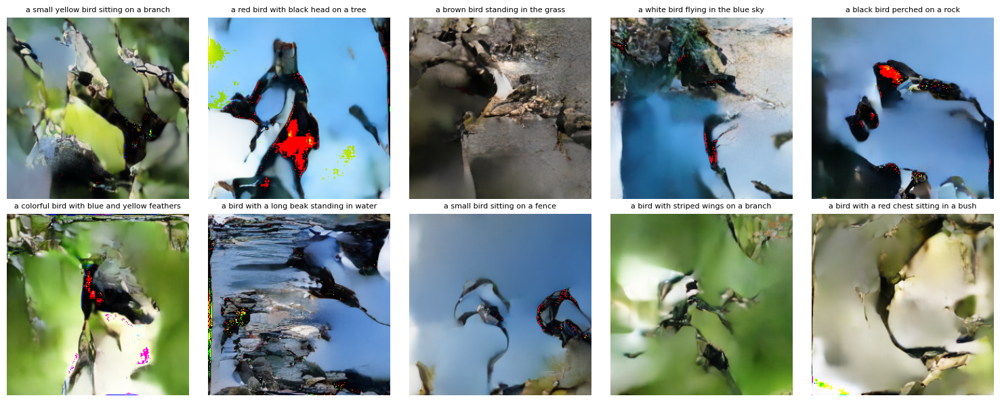

In [ ]:
generated_imgs = plot_generated_samples_with_prompts_сfg(cfgModel, vqvae, prompts, prompts_embs, num_samples=10, cfg_scale=1, temperature=0.9)

  0%|          | 0/32 [00:00<?, ?it/s]

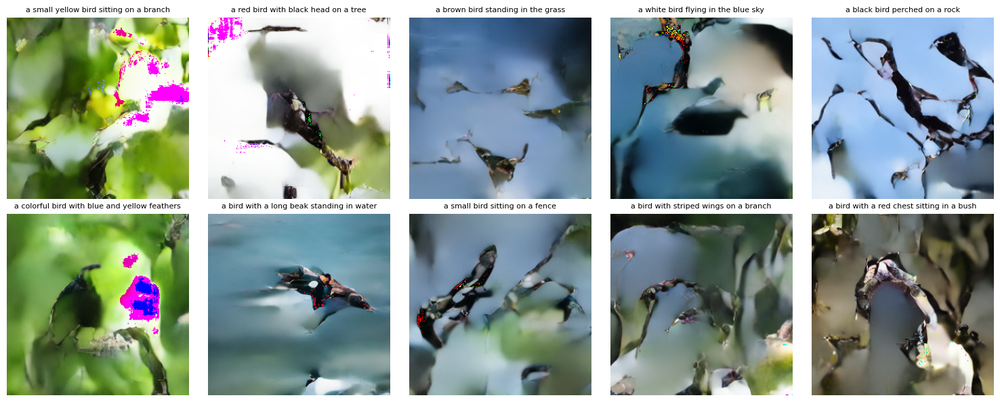

In [ ]:
generated_imgs = plot_generated_samples_with_prompts_сfg(cfgModel, vqvae, prompts, prompts_embs, num_samples=10, cfg_scale=1.5, temperature=0.9)

  0%|          | 0/32 [00:00<?, ?it/s]

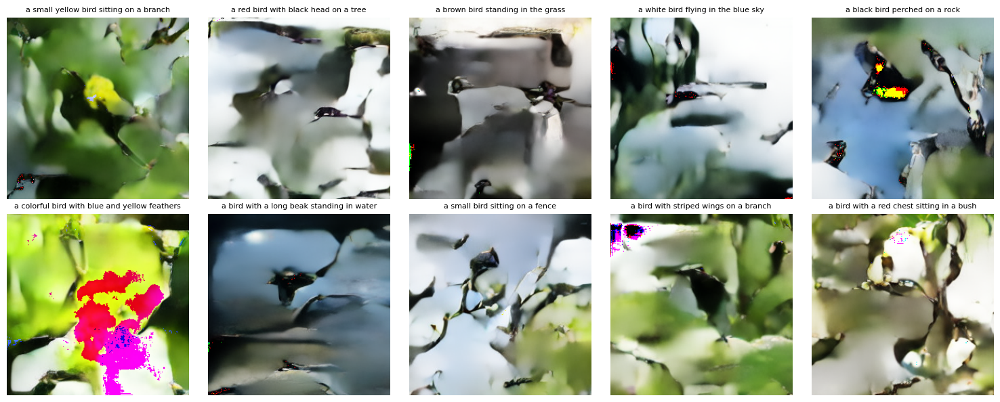

In [ ]:
generated_imgs = plot_generated_samples_with_prompts_сfg(cfgModel, vqvae, prompts, prompts_embs, num_samples=10, cfg_scale=2, temperature=0.9)

### Задание 7 (0.5 балла)

Реализуйте какую-нибудь метрику качества генерации - на ваш выбор (это может быть Inception Score, Frechet Inception Distance, LPIPS или что-то другое). Вам необходимо привести работающий код для вычисления метрики и текстом пояснить как работает метрика.

Далее вычислите значение этой метрики для обученной в задании 5 модели и сделайте выводы.

In [ ]:
feature_extractor = models.resnet50(pretrained=True)

feature_extractor = nn.Sequential(*list(feature_extractor.children())[:-1])

feature_extractor.eval()
feature_extractor.to(device)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 187MB/s]


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
def get_features(img_pil):
    preprocess = transforms.Compose([
        transforms.Resize((224, 224)),  # для ResNet
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                           std=[0.229, 0.224, 0.225])
    ])

    # Обрабатываем изображение
    img_tensor = preprocess(img_pil).unsqueeze(0).to(device)  # [1, 3, 224, 224]

    # Извлекаем фичи
    with torch.no_grad():
        features = feature_extractor(img_tensor)  # [1, 2048, 1, 1]
        features = features.view(features.size(0), -1)  # [1, 2048]

    return features.cpu().numpy()

In [ ]:
def fid(real_features, fake_features):
    # Средние значения
    mu_real = np.mean(real_features, axis=0)
    mu_fake = np.mean(fake_features, axis=0)

    # Ковариационные матрицы
    sigma_real = np.cov(real_features, rowvar=False)
    sigma_fake = np.cov(fake_features, rowvar=False)

    # Вычисляем FID
    diff = mu_real - mu_fake
    covmean = sqrtm(sigma_real.dot(sigma_fake))

    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff.dot(diff) + np.trace(sigma_real + sigma_fake - 2*covmean)

    return fid

In [ ]:
def calculate_fid(test_dataset, model, prompts_embs, temperature, num_samples=10):
    real_features_list = []
    real_images_to_show = []
    fake_features_list = []
    fake_images_to_show = []
    generated_codes = model.sample(prompts_embs, (num_samples, 32, 32), temperature=temperature)
    for i in tqdm(range(num_samples)):
        sample = test_dataset[i]
        codes = sample['codes'].unsqueeze(0)
        img_tensor = codes_to_img(codes, vqvae.to("cpu"))
        real_img = transforms.ToPILImage()(img_tensor[0].cpu())
        real_images_to_show.append(real_img)
        real_features = get_features(real_img)
        real_features_list.append(real_features)
        codes_i = generated_codes[i:i+1].to(device)
        img_tensor = codes_to_img(codes_i.to("cpu"), vqvae.to("cpu"))
        fake_img = transforms.ToPILImage()(img_tensor[0].cpu())
        fake_images_to_show.append(fake_img)
        fake_features = get_features(fake_img)
        fake_features_list.append(fake_features)
    real_features = np.vstack(real_features_list)
    fake_features = np.vstack(fake_features_list)
    fid_score = fid(real_features, fake_features)
    fig, axes = plt.subplots(2, num_samples, figsize=(15, 6))
    for i in range(num_samples):
        axes[0, i].imshow(real_images_to_show[i])
        axes[0, i].set_title(f"Реальное {i+1}", fontsize=10)
        axes[0, i].axis('off')

    for i in range(num_samples):
        axes[1, i].imshow(fake_images_to_show[i])
        axes[1, i].set_title(f"Сгенерированное {i+1}", fontsize=10)
        axes[1, i].axis('off')

    plt.suptitle(f"FID = {fid_score}", fontsize=14)
    plt.tight_layout()
    plt.show()
    return fid_score

100%|██████████| 10/10 [00:22<00:00,  2.21s/it]


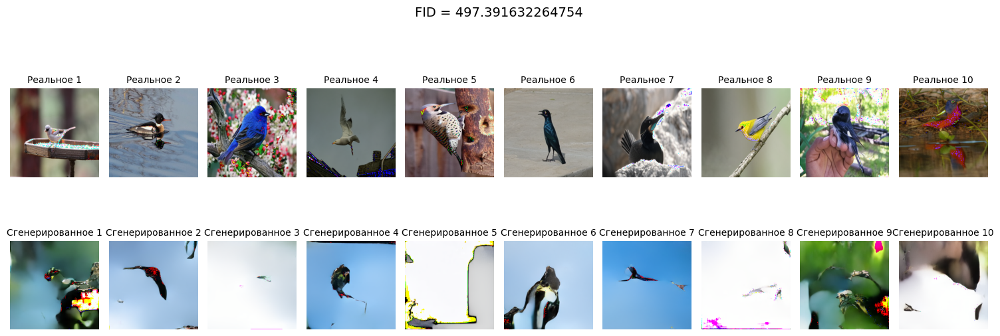

497.391632264754


In [ ]:
print(calculate_fid(test_dataset, conModel, prompts_embs, temperature=0.8))

100%|██████████| 10/10 [00:22<00:00,  2.23s/it]


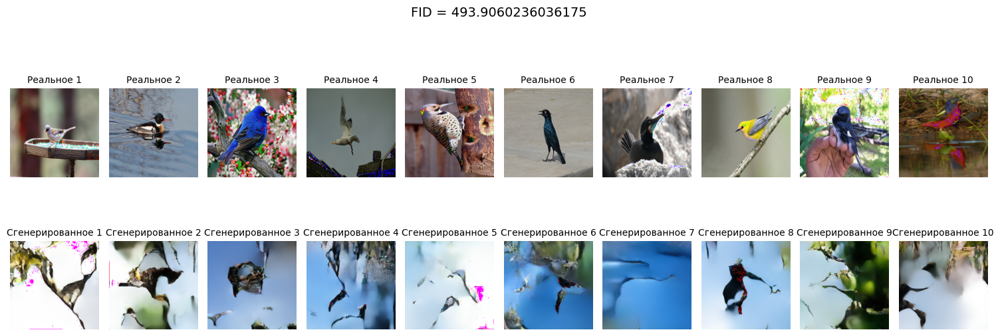

493.9060236036175


In [ ]:
print(calculate_fid(test_dataset, conModel, prompts_embs, temperature=0.9))

FID - Измеряет сходство между реальными и сгенерированными изображениями (чем меньше число - тем лучше)

Формула FID выглядит следующим образом:
FID = ||μ₁ - μ₂||² + Tr(Σ₁ + Σ₂ - 2√(Σ₁Σ₂))

Где:

-μ₁, μ₂-средние векторы признаков реальных и сгенерированных изображений

-Σ₁, Σ₂-ковариационные матрицы признаков реальных и сгенерированных изображений

-||·||²-квадрат евклидовой нормы (L2-нормы)

-Tr(·)-след матрицы (сумма диагональных элементов)

-√(·)-матричный квадратный корень

Чтобы найти ковариационные матрицы я использовала np.cov

На данный момент FID показывает, что сгенерированные изображения совсем отличаются от реальных и показатель 493,91(497.39 при T=0.8) является плохим(идеально нужно хотя бы иметь 100)

### Задание 8 (0.5 балла).

Можете делать любые действия для улучшения работы вашей модели (менять число слоев, параметры архитектуры - не отходя от концепции PixelCNN, менять гиперпараметры, делать аугментацию изображений и текстов и так далее).

Проведите эксперименты по улучшению качества модели - оценивайте качество модели с точки зрения:
- Реализованной в задании 7 метрики
- Визуально.

Мы ожидаем, что качество может не вырасти, но и не упадет.

In [ ]:
class LargerPixelCNN(ConditionalPixelCNNWithCFG):
    def __init__(self, num_embeddings, c_hidden, emb_dim, cond_dim, cfg_dropout_rate):
        super().__init__(num_embeddings, c_hidden, emb_dim, cond_dim, cfg_dropout_rate)

        self.embedding = nn.Embedding(num_embeddings, emb_dim)
        self.cond_proj = nn.Linear(cond_dim, emb_dim * 32 * 32)

        self.conv_layers = nn.ModuleList([
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=1),
            GatedMaskedConv(c_hidden, dilation=2),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=4),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden, dilation=2),
            GatedMaskedConv(c_hidden),
            GatedMaskedConv(c_hidden)
        ])

        self.residual_proj = nn.Conv2d(c_hidden, c_hidden, 1)

    def forward(self, x, cond, use_cfg=False, cfg_scale=1.5):
        if use_cfg and self.training:
            batch_size = cond.shape[0]
            mask = torch.rand(batch_size, 1, device=cond.device) < self.cfg_dropout_rate
            cond = torch.where(mask, self.null_embed.expand_as(cond), cond)

        B, H, W = x.shape
        x_emb = self.embedding(x).permute(0, 3, 1, 2)
        cond_proj = self.cond_proj(cond).view(B, -1, H, W)
        x_emb = x_emb + cond_proj

        v_stack = self.conv_vstack(x_emb)
        h_stack = self.conv_hstack(x_emb)

        residual = h_stack

        for i, layer in enumerate(self.conv_layers):
            v_stack, h_stack = layer(v_stack, h_stack)

            if i % 3 == 2:
                h_stack = h_stack + self.residual_proj(residual)
                residual = h_stack

        return self.conv_out(F.elu(h_stack))

In [ ]:
def train_larger_model(**kwargs):
    trainer = pl.Trainer(
        default_root_dir=os.path.join(CHECKPOINT_PATH, "LargerPixelCNN"),
        accelerator="gpu" if str(device).startswith("cuda") else "cpu",
        devices=1,
        max_epochs=max_epochs,
        callbacks=[
            ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_bpd"),
            LearningRateMonitor("epoch")
        ]
    )

    result = None
    pretrained_filename = os.path.join(CHECKPOINT_PATH, "LargerPixelCNN.ckpt")

    if os.path.isfile(pretrained_filename):
        model = LargerPixelCNN.load_from_checkpoint(pretrained_filename)
        ckpt = torch.load(pretrained_filename, map_location=device)
        result = ckpt.get("result", None)
    else:
        model = LargerPixelCNN(**kwargs)
        trainer.fit(model, train_loader, val_loader)

    model = model.to(device)

    if result is None:
        val_result = trainer.test(model, val_loader, verbose=False)
        test_result = trainer.test(model, test_loader, verbose=False)
        result = {"test": test_result, "val": val_result}

    return model, result

In [ ]:
max_epochs = 40
cfgLargerModel, cfgLargerResult = train_larger_model(num_embeddings=4096, c_hidden=128, emb_dim=64, cond_dim=512, cfg_dropout_rate=0.1)
cfgLargerTest_res = cfgLargerResult["test"][0]
print("Test bits per dimension: %4.3fbpd" % (cfgLargerTest_res["test_loss"] if "test_loss" in cfgLargerTest_res else cfgLargerTest_res["test_bpd"]))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type                       | Params | Mode 
---------------------------------------------------------------------
0 | embedding     | Embedding                  | 262 K  | train
1 | cond_proj     | Linear                     | 33.6 M | train
2 | conv_vstack   | VerticalStackConvolution   | 73.9 K | train
3 | conv_hstack   | HorizontalStackConvolution | 24.7 K | train
4 | conv_layers   | ModuleList                 | 4.3 M  | train
5 | conv_out      | Conv2d                     | 528 K  | train
6 | residual_proj | Conv2d                     | 16.5 K | train
  | other params  | n/a                   

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=40` reached.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

Test bits per dimension: 10.573bpd


  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

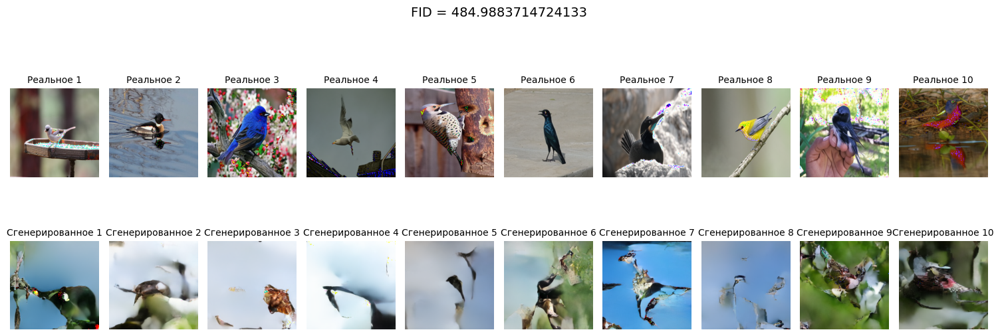

484.9883714724133


In [ ]:
print(calculate_fid(test_dataset, cfgLargerModel, prompts_embs, temperature=0.9, num_samples=len(prompts)))

Метрика улучшилась за счёт увеличения слоев и визуально картинки более подходят под описания промптов(фон и цвета более подходят под задачу)!
* "a small yellow bird sitting on a branch",
* "a red bird with black head on a tree",
* "a brown bird standing in the grass",
* "a white bird flying in the blue sky",
* "a black bird perched on a rock",
* "a colorful bird with blue and yellow feathers",
* "a bird with a long beak standing in water",
* "a small bird sitting on a fence",
* "a bird with striped wings on a branch",
* "a bird with a red chest sitting in a bush"

### Задание 9 (1.5 балла).

Проанализируйте лучшую модель:

- Придумайте 5 разных признаков (например, цвет, вид оперения, длина клюва, лап и так далее) и посмотрите, будет ли модель их понимать благодаря текстовому эмбеддингу? (0.5 балла)

- Попробуйте добавлять в модель другие промпты - не связанные с птицами, или по-другому построенные (не "a photo of", а по-другому сформулированные). Как отрабатывает модель? (0.5 балла)

- Фиксируйте удачный промпт и проведите эксперименты по изменению веса guidance в classifer-free подходе. Сделайте выводы. (0.5 балла)

In [ ]:
prompts = ["a bird with yellow plumage", "a bird with green plumage", # цвет оперения
           "a bird with downy feathers", "a bird with contoured feathers", # вид оперения
           "a bird with short legs", "a bird with long legs", # длина лап
           "a bird with a short beak", "a small bird sitting on a fence", # длина клюва
           "a bird with curved beak", "a bird with straight beak"] #форма клюва
prompts_embs_1 = encode_texts(prompts, tokenizer, model).to("cpu")

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

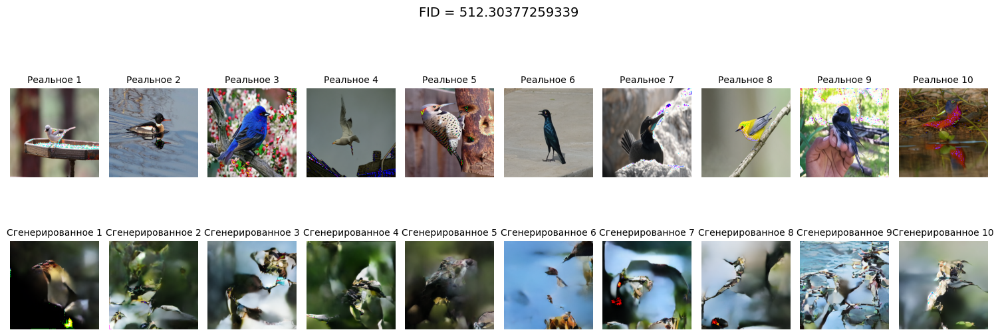

512.30377259339


In [ ]:
print(calculate_fid(test_dataset, cfgLargerModel, prompts_embs_1, temperature=0.9))

Судя по данным промптам угадали только с цветом птиц . И даже на одной кратинке(первой) есть её очертания

In [ ]:
prompts_alt = ["a monkey on a branch", "a little mouse in the house", "a car on the road"]
prompts_embs_2 = encode_texts(prompts_alt, tokenizer, model).to("cpu")

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

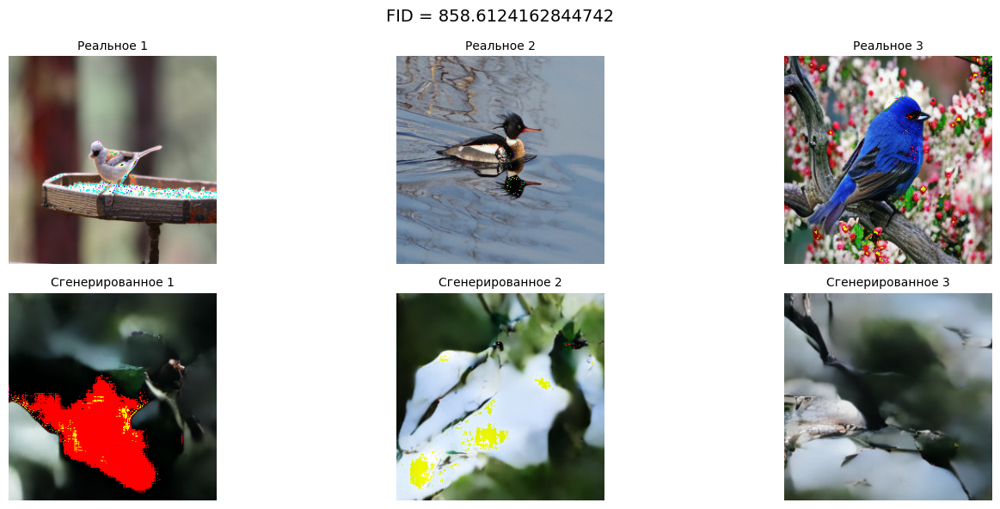

858.6124162844742


In [ ]:
print(calculate_fid(test_dataset, cfgLargerModel, prompts_embs_2, temperature=0.9, num_samples = 3))

В данном случае вообще не работает и максимально, что можно разглядеть - это правильный цвет фона леса и ветки для первого промпта

In [ ]:
prompt = ["a bird with yellow plumage"]
prompts_embs_3 = encode_texts(prompt, tokenizer, model).to("cpu")

  0%|          | 0/32 [00:00<?, ?it/s]

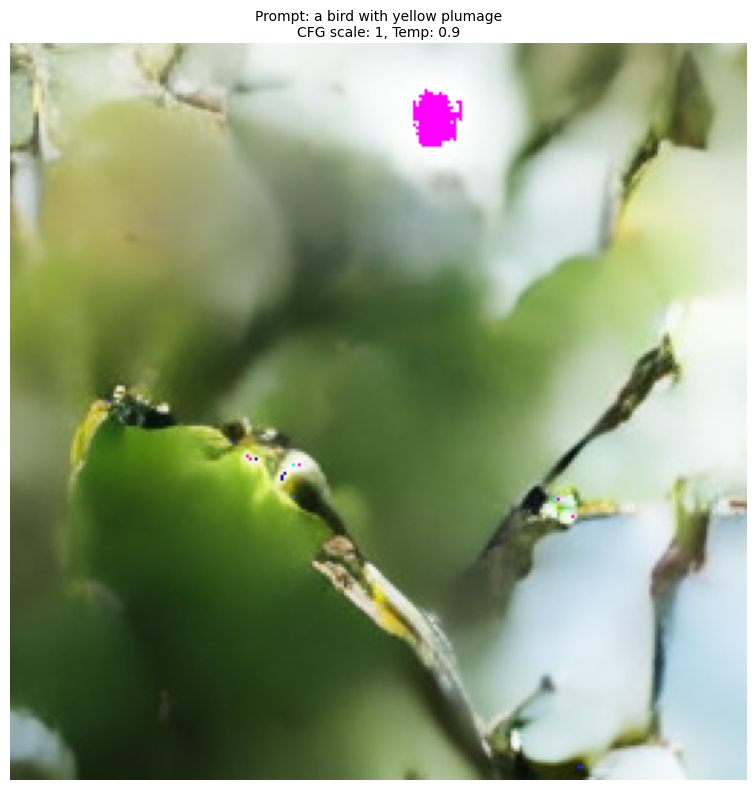

In [ ]:
generated_imgs = plot_generated_samples_with_prompts_сfg(cfgLargerModel, vqvae, prompt, prompts_embs_3, num_samples=1, cfg_scale=1, temperature=0.9)

  0%|          | 0/32 [00:00<?, ?it/s]

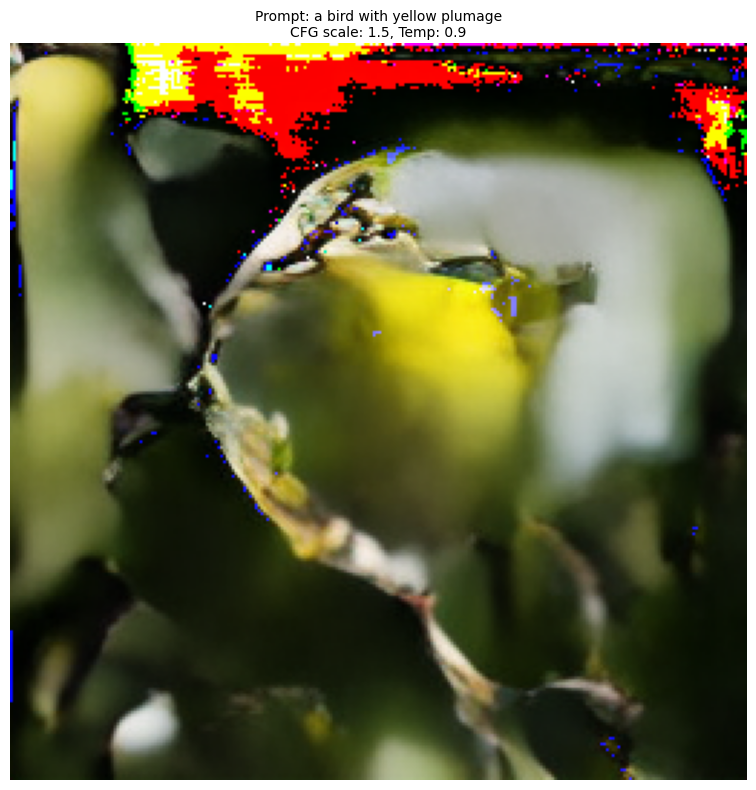

In [ ]:
generated_imgs = plot_generated_samples_with_prompts_сfg(cfgLargerModel, vqvae, prompt, prompts_embs_3, num_samples=1, cfg_scale=1.5, temperature=0.9)

  0%|          | 0/32 [00:00<?, ?it/s]

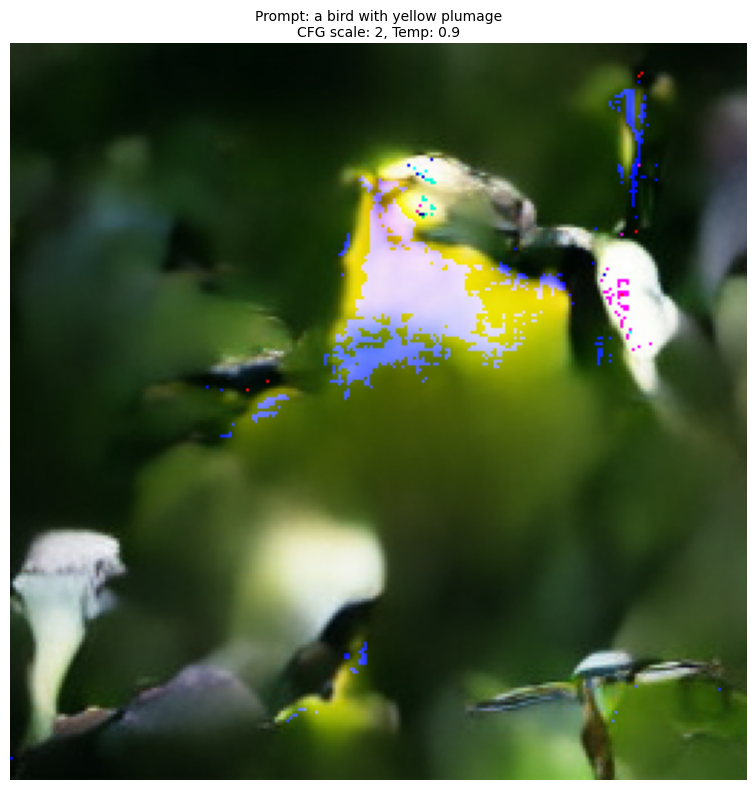

In [ ]:
generated_imgs = plot_generated_samples_with_prompts_сfg(cfgLargerModel, vqvae, prompt, prompts_embs_3, num_samples=1, cfg_scale=2, temperature=0.9)

Несмотря на "кляксы" самый гармоничный результат был получен для промпта "a bird with yellow plumage" при guidance=2